<a href="https://www.kaggle.com/code/srivabhi22/notebook3956eed930?scriptVersionId=160266977" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/weights/best.pth
/kaggle/input/birdsong-recognition/example_test_audio_metadata.csv
/kaggle/input/birdsong-recognition/sample_submission.csv
/kaggle/input/birdsong-recognition/train.csv
/kaggle/input/birdsong-recognition/test.csv
/kaggle/input/birdsong-recognition/example_test_audio_summary.csv
/kaggle/input/birdsong-recognition/example_test_audio/ORANGE-7-CAP_20190606_093000.pt623.mp3
/kaggle/input/birdsong-recognition/example_test_audio/BLKFR-10-CPL_20190611_093000.pt540.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC153881.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC423355.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC45484.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC109911.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC299486.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC474580.mp3
/kaggle/input/birdsong-recognition/train_audio/rudduc/XC299484.mp3
/kaggle/input/birdsong-recognition/t

In [2]:
import cv2
import audioread
import logging
import random
import time
import warnings


from contextlib import contextmanager
from pathlib import Path
from typing import Optional

import soundfile as sf
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset
import torch.utils.data as data
from torch.utils.data import DataLoader

from contextlib import contextmanager
from pathlib import Path
from typing import Optional

from fastprogress import progress_bar
from sklearn.metrics import f1_score
from torchvision import models

def set_seed(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)  # type: ignore
    torch.backends.cudnn.deterministic = True  # type: ignore
    torch.backends.cudnn.benchmark = True  # type: ignore
    

def get_logger(out_file=None):
    logger = logging.getLogger()
    formatter = logging.Formatter("%(asctime)s - %(levelname)s - %(message)s")
    logger.handlers = []
    logger.setLevel(logging.INFO)

    handler = logging.StreamHandler()
    handler.setFormatter(formatter)
    handler.setLevel(logging.INFO)
    logger.addHandler(handler)

    if out_file is not None:
        fh = logging.FileHandler(out_file)
        fh.setFormatter(formatter)
        fh.setLevel(logging.INFO)
        logger.addHandler(fh)
    logger.info("logger set up")
    return logger

    
@contextmanager
def timer(name: str, logger: Optional[logging.Logger] = None):
    t0 = time.time()
    msg = f"[{name}] start"
    if logger is None:
        print(msg)
    else:
        logger.info(msg)
    yield

    msg = f"[{name}] done in {time.time() - t0:.2f} s"
    if logger is None:
        print(msg)
    else:
        logger.info(msg)

        
logger = get_logger("main.log")
set_seed(1213)

2024-01-24 14:36:02,550 - INFO - logger set up


In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_columns',None)
pd.set_option('display.expand_frame_repr',False)
data=pd.read_csv("/kaggle/input/birdsong-recognition/train.csv")
data

,rating,playback_used,ebird_code,channels,date,pitch,duration,filename,speed,species,number_of_notes,title,secondary_labels,bird_seen,sci_name,location,latitude,sampling_rate,type,elevation,description,bitrate_of_mp3,file_type,volume,background,xc_id,url,country,author,primary_label,longitude,length,time,recordist,license
0,3.5,no,aldfly,1 (mono),2013-05-25,Not specified,25,XC134874.mp3,Not specified,Alder Flycatcher,Not specified,XC134874 Alder Flycatcher (Empidonax alnorum),"['Empidonax minimus_Least Flycatcher', 'Leioth...",yes,Empidonax alnorum,"Grey Cloud Dunes SNA, Washington, Minnesota",44.793,48000 (Hz),call,220 m,Two short segments of fairly quiet *pip* calls...,192000 (bps),mp3,Not specified,American Yellow Warbler (Setophaga aestiva); L...,134874,https://www.xeno-canto.org/134874,United States,Jonathon Jongsma,Empidonax alnorum_Alder Flycatcher,-92.962,Not specified,8:00,Jonathon Jongsma,Creative Commons Attribution-ShareAlike 3.0
1,4.0,no,aldfly,2 (stereo),2013-05-27,both,36,XC135454.mp3,both,Alder Flycatcher,1-3,XC135454 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,At least three birds seen here moving around s...,128000 (bps),mp3,level,NaN,135454,https://www.xeno-canto.org/135454,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
2,4.0,no,aldfly,2 (stereo),2013-05-27,both,39,XC135455.mp3,both,Alder Flycatcher,1-3,XC135455 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,At least three birds seen chasing each other a...,128000 (bps),mp3,level,NaN,135455,https://www.xeno-canto.org/135455,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
3,3.5,no,aldfly,2 (stereo),2013-05-27,both,33,XC135456.mp3,both,Alder Flycatcher,1-3,XC135456 Alder Flycatcher (Empidonax alnorum),"['Dumetella carolinensis_Gray Catbird', 'Bomby...",yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,img:http://www.flickr.com/photos/madbirder/888...,128000 (bps),mp3,level,Grey Catbird (Dumetella carolinensis); Cedar W...,135456,https://www.xeno-canto.org/135456,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
4,4.0,no,aldfly,2 (stereo),2013-05-27,both,36,XC135457.mp3,level,Alder Flycatcher,1-3,XC135457 Alder Flycatcher (Empidonax alnorum),[],yes,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,img:http://www.flickr.com/photos/madbirder/888...,128000 (bps),mp3,level,NaN,135457,https://www.xeno-canto.org/135457,United States,Mike Nelson,Empidonax alnorum_Alder Flycatcher,-82.1106,0-3(s),08:30,Mike Nelson,Creative Commons Attribution-NonCommercial-Sha...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21370,4.5,no,yetvir,1 (mono),2019-05-15,both,28,XC477608.mp3,level,Yellow-throated Vireo,4-6,XC477608 Yellow-throated Vireo (Vireo flavifrons),"['Dryobates pubescens_Downy Woodpecker', 'Poli...",yes,Vireo flavifrons,"Spring Valley (near Waynesville), Greene Cty...",39.5734,48000 (Hz),song,220 m,Natural vocalization,192000 (bps),mp3,both,Downy Woodpecker (Dryobates pubescens); Blue-g...,477608,https://www.xeno-canto.org/477608,United States,Sue Riffe,Vireo flavifrons_Yellow-throated Vireo,-84.0131,0-3(s),13:00,Sue Riffe,Creative Commons Attribution-NonCommercial-Sha...
21371,3.5,no,yetvir,1 (mono),2017-05-14,Not specified,52,XC500348.mp3,Not specified,Yellow-throated Vireo,Not specified,XC500348 Yellow-throated Vireo (Vireo flavifrons),"['Vireo olivaceus_Red-

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21375 entries, 0 to 21374
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   rating            21375 non-null  float64
 1   playback_used     19575 non-null  object 
 2   ebird_code        21375 non-null  object 
 3   channels          21375 non-null  object 
 4   date              21375 non-null  object 
 5   pitch             21375 non-null  object 
 6   duration          21375 non-null  int64  
 7   filename          21375 non-null  object 
 8   speed             21375 non-null  object 
 9   species           21375 non-null  object 
 10  number_of_notes   21375 non-null  object 
 11  title             21375 non-null  object 
 12  secondary_labels  21375 non-null  object 
 13  bird_seen         19575 non-null  object 
 14  sci_name          21375 non-null  object 
 15  location          21375 non-null  object 
 16  latitude          21375 non-null  object

In [5]:
from sklearn.preprocessing import OneHotEncoder, LabelEncoder,StandardScaler

scale=StandardScaler()
hot_encoder=OneHotEncoder()
label_encoder=LabelEncoder()

data=data.drop(['url','title','recordist','description','xc_id','author','primary_label','time','length','background','number_of_notes','volume'],axis=1)

data['playback_used']=label_encoder.fit_transform(data['playback_used'])
data['channels']=label_encoder.fit_transform(data['channels'])
data['bird_seen']=label_encoder.fit_transform(data['bird_seen'])

In [6]:
# /kaggle/input/birdsong-recognition/train_audio/amebit/XC256198.mp3
# /kaggle/input/birdsong-recognition/train_audio/amebit/XC149911.mp3
# /kaggle/input/birdsong-recognition/train_audio/amebit/XC184879.mp3
# /kaggle/input/birdsong-recognition/train_audio/amebit/XC466915.mp3
# /kaggle/input/birdsong-recognition/train_audio/amebit/XC314525.mp3

for i in range(len(data)):
    
    data.loc[i,'filename']='/kaggle/input/birdsong-recognition/train_audio/'+str(data.loc[i,'ebird_code'])+'/'+data.loc[i,'filename']

    
    
data['month']=data['date'].apply(lambda x:x.split('-')[1]).astype(int)

data=data.drop(['date'],axis=1)
data.head()

,rating,playback_used,ebird_code,channels,pitch,duration,filename,speed,species,secondary_labels,bird_seen,sci_name,location,latitude,sampling_rate,type,elevation,bitrate_of_mp3,file_type,country,longitude,license,month
0,3.5,0,aldfly,0,Not specified,25,/kaggle/input/birdsong-recognition/train_audio...,Not specified,Alder Flycatcher,"['Empidonax minimus_Least Flycatcher', 'Leioth...",1,Empidonax alnorum,"Grey Cloud Dunes SNA, Washington, Minnesota",44.793,48000 (Hz),call,220 m,192000 (bps),mp3,United States,-92.962,Creative Commons Attribution-ShareAlike 3.0,5
1,4.0,0,aldfly,1,both,36,/kaggle/input/birdsong-recognition/train_audio...,both,Alder Flycatcher,[],1,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,128000 (bps),mp3,United States,-82.1106,Creative Commons Attribution-NonCommercial-Sha...,5
2,4.0,0,aldfly,1,both,39,/kaggle/input/birdsong-recognition/train_audio...,both,Alder Flycatcher,[],1,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,128000 (bps),mp3,United States,-82.1106,Creative Commons Attribution-NonCommercial-Sha...,5
3,3.5,0,aldfly,1,both,33,/kaggle/input/birdsong-recognition/train_audio...,both,Alder Flycatcher,"['Dumetella carolinensis_Gray Catbird', 'Bomby...",1,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,128000 (bps),mp3,United States,-82.1106,Creative Commons Attribution-NonCommercial-Sha...,5
4,4.0,0,aldfly,1,both,36,/kaggle/input/birdsong-recognition/train_audio...,level,Alder Flycatcher,[],1,Empidonax alnorum,"Carver's Gap Parking area, Roan Mountain Stat...",36.1065,44100 (Hz),"call, song",1700 m,128000 (bps),mp3,United States,-82.1106,Creative Commons Attribution-NonCommercial-Sha...,5


In [7]:

data['longitude'].replace({'Not specified': np.NaN},inplace =True)

In [8]:
data['longitude']=data['longitude'].astype(float)

In [9]:
data['pitch']=label_encoder.fit_transform(data['pitch'])
data['speed']=label_encoder.fit_transform(data['speed'])
data['species']=label_encoder.fit_transform(data['species'])
data['secondary_labels']=label_encoder.fit_transform(data['secondary_labels'])
data['sci_name']=label_encoder.fit_transform(data['sci_name'])
data['location']=label_encoder.fit_transform(data['location'])
data['type']=label_encoder.fit_transform(data['type'])
data['file_type']=label_encoder.fit_transform(data['type'])
data['country']=label_encoder.fit_transform(data['country'])
data['license']=label_encoder.fit_transform(data['license'])



In [10]:
data=data.drop(['elevation','bitrate_of_mp3'],axis=1)

In [11]:
data['sampling_rate']=data['sampling_rate'].apply(lambda x:x.split(' ')[0]).astype(int)


In [12]:
data=data[data['latitude']!='Not specified']

In [13]:
data['latitude']=data['latitude'].astype(float)

In [14]:
X=data.drop(['ebird_code'],axis=1)
y=data['ebird_code']
from sklearn.preprocessing import StandardScaler
scale=StandardScaler()
for columns in X.columns:
    if columns!='filename':
        X[columns]=scale.fit_transform(np.array(X[columns]).reshape(-1,1))
        
X

,rating,playback_used,channels,pitch,duration,filename,speed,species,secondary_labels,bird_seen,sci_name,location,latitude,sampling_rate,type,file_type,country,longitude,license,month
0,-0.581178,-0.337106,-0.928635,-0.549509,-0.406044,/kaggle/input/birdsong-recognition/train_audio...,-0.618584,-1.705839,-1.472952,0.15968,-0.662823,-0.597770,0.465275,0.816741,-0.921736,-0.921736,0.603714,-0.155638,2.433014,-0.321838
1,-0.073880,-0.337106,1.076849,0.140239,-0.262264,/kaggle/input/birdsong-recognition/train_audio...,0.558529,-1.705839,0.640891,0.15968,-0.662823,-1.277674,-0.154213,-0.388731,-0.043898,-0.043898,0.603714,0.087945,-1.676055,-0.321838
2,-0.073880,-0.337106,1.076849,0.140239,-0.223051,/kaggle/input/birdsong-recognition/train_audio...,0.558529,-1.705839,0.640891,0.15968,-0.662823,-1.277674,-0.154213,-0.388731,-0.043898,-0.043898,0.603714,0.087945,-1.676055,-0.321838
3,-0.581178,-0.337106,1.076849,0.140239,-0.301477,/kaggle/input/birdsong-recognition/train_audio...,0.558529,-1.705839,-1.527436,0.15968,-0.662823,-1.277674,-0.154213,-0.388731,-0.043898,-0.043898,0.603714,0.087945,-1.676055,-0.321838
4,-0.073880,-0.337106,1.076849,0.140239,-0.262264,/kaggle/input/birdsong-recognition/train_audio...,1.735641,-1.705839,0.640891,0.15968,-0.662823,-1.277674,-0.154213,-0.388731,-0.043898,-0.043898,0.603714,0.087945,-1.676055,-0.321838
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21370,0.433419,-0.337106,-0.928635,0.140239,-0.366832,/kaggle/input/birdsong-recognition/train_audio...,1.735641,1.766826,-1.540904,0.15968,1.566530,1.180785,0.093033,0.816741,1.135003,1.135003,0.603714,0.045239,0.378480,-0.321838
21371,-0.581178,-0.337106,-0.928635,-0.549509,-0.053129,/kaggle/input/birdsong-recognition/train_audio...,-0.618584,1.766826,0.443770,0.15968,1.566530,-1.066631,0.006633,0.816741,1.135003,1.135003,0.603714,0.194982,0.378480,-0.321838
21372,0.940717,-0.337106,-0.928635,-0.549509,0.521992,/kaggle/input/birdsong-recognition/train_audio...,-0.618584,1.766826,0.640891,0.15968,1.566530,-1.066631,0.006633,0.816741,1.135003,1.135003,0.603714,0.194982,0.378480,0.068356
21373,-0.581178,-0.337106,1.076849,2.209485,-0.275335,/kaggle/input/birdsong-recognition/train_audio...,1.735641,1.766826,-1.921677,0.15968,1.566530,1.082781,-0.161751,-0.388731,1.135003,1.135003,0.603714,0.046741,-1.676055,-0.321838


array([[<Axes: title={'center': 'rating'}>,
        <Axes: title={'center': 'playback_used'}>,
        <Axes: title={'center': 'channels'}>,
        <Axes: title={'center': 'pitch'}>],
       [<Axes: title={'center': 'duration'}>,
        <Axes: title={'center': 'speed'}>,
        <Axes: title={'center': 'species'}>,
        <Axes: title={'center': 'secondary_labels'}>],
       [<Axes: title={'center': 'bird_seen'}>,
        <Axes: title={'center': 'sci_name'}>,
        <Axes: title={'center': 'location'}>,
        <Axes: title={'center': 'latitude'}>],
       [<Axes: title={'center': 'sampling_rate'}>,
        <Axes: title={'center': 'type'}>,
        <Axes: title={'center': 'file_type'}>,
        <Axes: title={'center': 'country'}>],
       [<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'license'}>,
        <Axes: title={'center': 'month'}>, <Axes: >]], dtype=object)

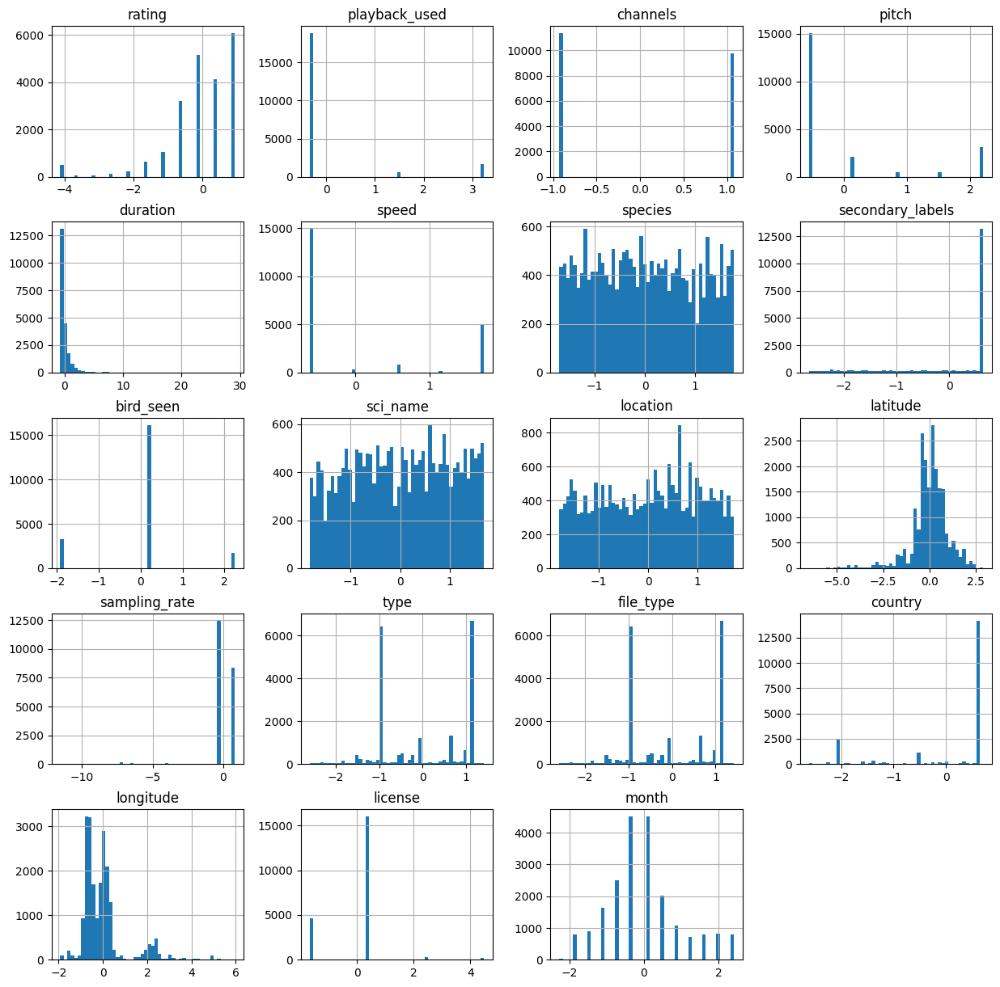

In [15]:
X.hist(figsize=(15,15),bins=50)

In [16]:
unique_bird_labels=label_encoder.fit_transform(y.unique())
bird_code=dict(zip(unique_bird_labels,y.unique()))
y=label_encoder.fit_transform(y)


In [17]:
bird_code  ##labels assigned to each category of bird

{0: 'aldfly',
 1: 'ameavo',
 2: 'amebit',
 3: 'amecro',
 4: 'amegfi',
 5: 'amekes',
 6: 'amepip',
 7: 'amered',
 8: 'amerob',
 9: 'amewig',
 10: 'amewoo',
 11: 'amtspa',
 12: 'annhum',
 13: 'astfly',
 14: 'baisan',
 15: 'baleag',
 16: 'balori',
 17: 'banswa',
 18: 'barswa',
 19: 'bawwar',
 20: 'belkin1',
 21: 'belspa2',
 22: 'bewwre',
 23: 'bkbcuc',
 24: 'bkbmag1',
 25: 'bkbwar',
 26: 'bkcchi',
 27: 'bkchum',
 28: 'bkhgro',
 29: 'bkpwar',
 30: 'bktspa',
 31: 'blkpho',
 32: 'blugrb1',
 33: 'blujay',
 34: 'bnhcow',
 35: 'boboli',
 36: 'bongul',
 37: 'brdowl',
 38: 'brebla',
 39: 'brespa',
 40: 'brncre',
 41: 'brnthr',
 42: 'brthum',
 43: 'brwhaw',
 44: 'btbwar',
 45: 'btnwar',
 46: 'btywar',
 47: 'buffle',
 48: 'buggna',
 49: 'buhvir',
 50: 'bulori',
 51: 'bushti',
 52: 'buwtea',
 53: 'buwwar',
 54: 'cacwre',
 55: 'calgul',
 56: 'calqua',
 57: 'camwar',
 58: 'cangoo',
 59: 'canwar',
 60: 'canwre',
 61: 'carwre',
 62: 'casfin',
 63: 'caster1',
 64: 'casvir',
 65: 'cedwax',
 66: 'chispa',


In [18]:
target_df=pd.DataFrame({'target':y})

In [19]:
new_data=pd.concat([X,target_df],axis=1,join="inner")
new_data=new_data.drop(['filename'],axis=1)

In [20]:
corr_matrix=new_data.corr()
corr_matrix

,rating,playback_used,channels,pitch,duration,speed,species,secondary_labels,bird_seen,sci_name,location,latitude,sampling_rate,type,file_type,country,longitude,license,month,target
rating,1.000000,-0.055410,-0.049756,0.002072,0.081105,0.000309,0.007612,0.171886,-0.005424,0.028823,0.005662,-0.009912,0.080730,0.095237,0.095237,0.006582,0.012790,0.009100,-0.033501,-0.005854
playback_used,-0.055410,1.000000,-0.064071,0.042746,-0.020980,0.069649,0.000502,-0.011314,0.641655,-0.002986,-0.003954,-0.075184,-0.048168,-0.040075,-0.040075,-0.118267,0.033461,-0.147758,-0.018920,0.011302
channels,-0.049756,-0.064071,1.000000,-0.006489,-0.126863,-0.034913,-0.000571,0.099324,-0.001914,-0.029737,-0.055864,0.086180,-0.084585,-0.014420,-0.014420,-0.115075,0.238187,0.059363,0.018395,-0.015444
pitch,0.002072,0.042746,-0.006489,1.000000,-0.022678,0.846996,-0.012341,-0.104381,0.041487,-0.003552,0.021620,-0.119096,-0.120286,-0.038196,-0.038196,-0.048636,-0.130587,-0.119597,-0.000459,-0.004648
duration,0.081105,-0.020980,-0.126863,-0.022678,1.000000,0.020859,0.009304,-0.158309,-0.010103,0.057784,0.001030,0.064791,0.042136,0.101484,0.101484,0.009792,-0.087322,0.055670,-0.028218,-0.001311
speed,0.000309,0.069649,-0.034913,0.846996,0.020859,1.000000,-0.004602,-0.142390,0.049788,0.020353,0.009502,-0.101087,-0.135742,0.016670,0.016670,-0.041984,-0.159047,-0.135094,-0.002440,0.006434
species,0.007612,0.000502,-0.000571,-0.012341,0.009304,-0.004602,1.000000,0.000614,-0.004420,-0.002768,-0.018857,0.055348,-0.012222,-0.013535,-0.013535,-0.040428,-0.026358,0.014240,0.026055,0.936249
secondary_labels,0.171886,-0.011314,0.099324,-0.104381,-0.158309,-0.142390,0.000614,1.000000,-0.009075,-0.017837,-0.017796,-0.026176,0.015170,-0.006731,-0.006731,-0.057573,0.090523,-0.038037,0.046718,-0.000832
bird_seen,-0.005424,0.641655,-0.001914,0.041487,-0.010103,0.049788,-0.004420,-0.009075,1.000000,-0.033387,-0.001221,-0.074125,-0.008636,-0.091645,-0.091645,-0.073433,0.063669,-0.124210,-0.009175,-0.000545
sci_name,0.028823,-0.002986,-0.029737,-0.003552,0.057784,0.020353,-0.002768,-0.017837,-0.033387,1.000000,-0.012150,0.000616,-0.010959,0.159155,0.159155,0.002475,-0.084480,0.030320,-0.016338,-0.007646


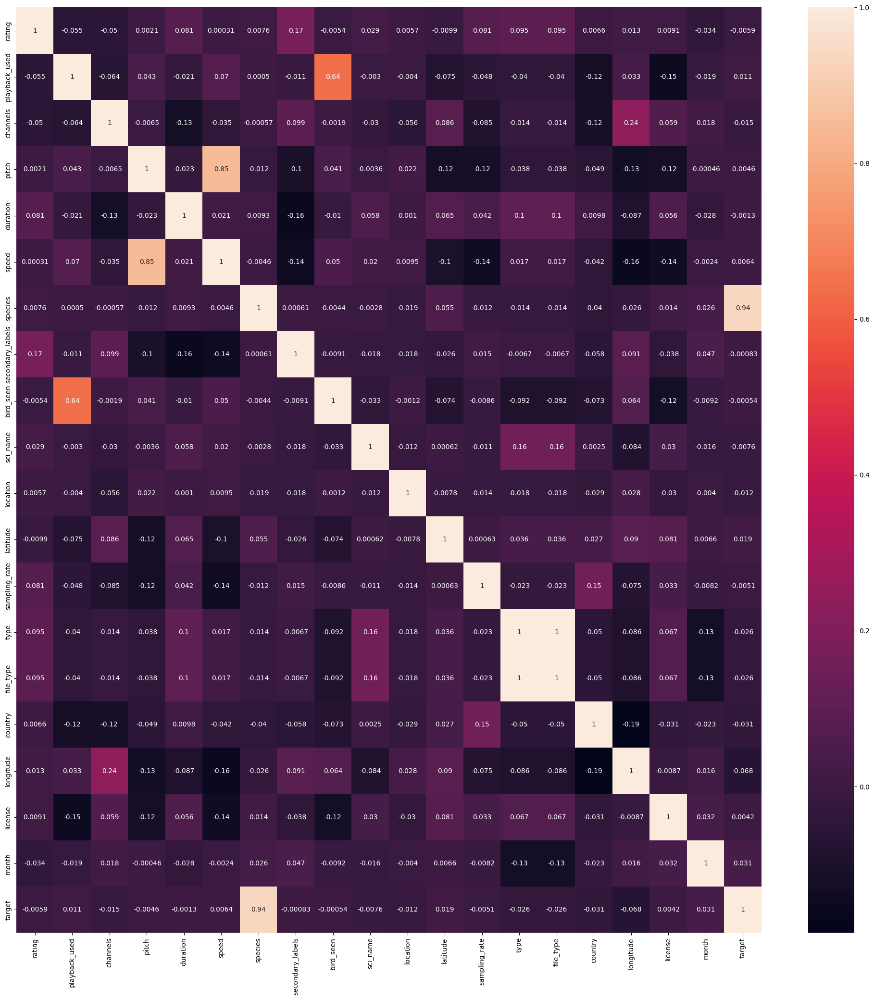

In [21]:
plt.figure(figsize=(25,25))
sns.heatmap(corr_matrix,annot=True)
plt.show()

<Axes: >

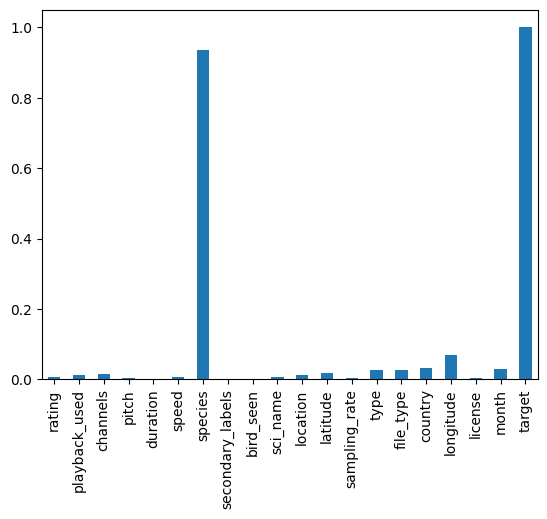

In [22]:
abs(corr_matrix['target']).plot(kind='bar')
#we see that only species feature is of great importance other than that we can drop.
#but still for convention, we can take longitude,latitutde,file_type,month and country.

In [23]:
#we are seeing that file type and type are the same feature so we are dropping type
X=X.drop(['type','rating','playback_used','channels','pitch','duration','speed','secondary_labels','bird_seen','sci_name','location','sampling_rate','license'],axis=1)
X

,filename,species,latitude,file_type,country,longitude,month
0,/kaggle/input/birdsong-recognition/train_audio...,-1.705839,0.465275,-0.921736,0.603714,-0.155638,-0.321838
1,/kaggle/input/birdsong-recognition/train_audio...,-1.705839,-0.154213,-0.043898,0.603714,0.087945,-0.321838
2,/kaggle/input/birdsong-recognition/train_audio...,-1.705839,-0.154213,-0.043898,0.603714,0.087945,-0.321838
3,/kaggle/input/birdsong-recognition/train_audio...,-1.705839,-0.154213,-0.043898,0.603714,0.087945,-0.321838
4,/kaggle/input/birdsong-recognition/train_audio...,-1.705839,-0.154213,-0.043898,0.603714,0.087945,-0.321838
...,...,...,...,...,...,...,...
21370,/kaggle/input/birdsong-recognition/train_audio...,1.766826,0.093033,1.135003,0.603714,0.045239,-0.321838
21371,/kaggle/input/birdsong-recognition/train_audio...,1.766826,0.006633,1.135003,0.603714,0.194982,-0.321838
21372,/kaggle/input/birdsong-recognition/train_audio...,1.766826,0.006633,1.135003,0.603714,0.194982,0.068356
21373,/kaggle/input/birdsong-recognition/train_audio...,1.766826,-0.161751,1.135003,0.603714,0.046741,-0.321838


In [24]:
import librosa
import IPython.display as ipd
import matplotlib.pyplot as plt


In [25]:
sub = pd.read_csv("/kaggle/input/birdsong-recognition/sample_submission.csv")
sub.to_csv("submission.csv", index=False)

In [26]:
audio_file_paths = ['/kaggle/input/birdsong-recognition/train_audio/aldfly/XC134874.mp3', '/kaggle/input/birdsong-recognition/train_audio/amecro/XC114560.mp3', '/kaggle/input/birdsong-recognition/train_audio/bawwar/XC130499.mp3',
                   '/kaggle/input/birdsong-recognition/train_audio/camwar/XC133791.mp3','/kaggle/input/birdsong-recognition/train_audio/cangoo/XC164606.mp3','/kaggle/input/birdsong-recognition/train_audio/comnig/XC156190.mp3',
                   '/kaggle/input/birdsong-recognition/train_audio/easblu/XC100032.mp3','/kaggle/input/birdsong-recognition/train_audio/grycat/XC135013.mp3','/kaggle/input/birdsong-recognition/train_audio/hamfly/XC123910.mp3','/kaggle/input/birdsong-recognition/train_audio/lesgol/XC112926.mp3']

# Loop through each audio file path
for audio_file_path in audio_file_paths:
    # Create an Audio instance for the audio file
    data_audio, sample_rate = librosa.load(audio_file_path)
    audio = ipd.Audio(data=data_audio,rate=sample_rate)

    print(audio_file_path)
    display(audio)
    
    
##displaying audios of some categories of birds

/kaggle/input/birdsong-recognition/train_audio/aldfly/XC134874.mp3


/kaggle/input/birdsong-recognition/train_audio/amecro/XC114560.mp3


/kaggle/input/birdsong-recognition/train_audio/bawwar/XC130499.mp3


/kaggle/input/birdsong-recognition/train_audio/camwar/XC133791.mp3


/kaggle/input/birdsong-recognition/train_audio/cangoo/XC164606.mp3


/kaggle/input/birdsong-recognition/train_audio/comnig/XC156190.mp3


/kaggle/input/birdsong-recognition/train_audio/easblu/XC100032.mp3


/kaggle/input/birdsong-recognition/train_audio/grycat/XC135013.mp3


/kaggle/input/birdsong-recognition/train_audio/hamfly/XC123910.mp3


/kaggle/input/birdsong-recognition/train_audio/lesgol/XC112926.mp3


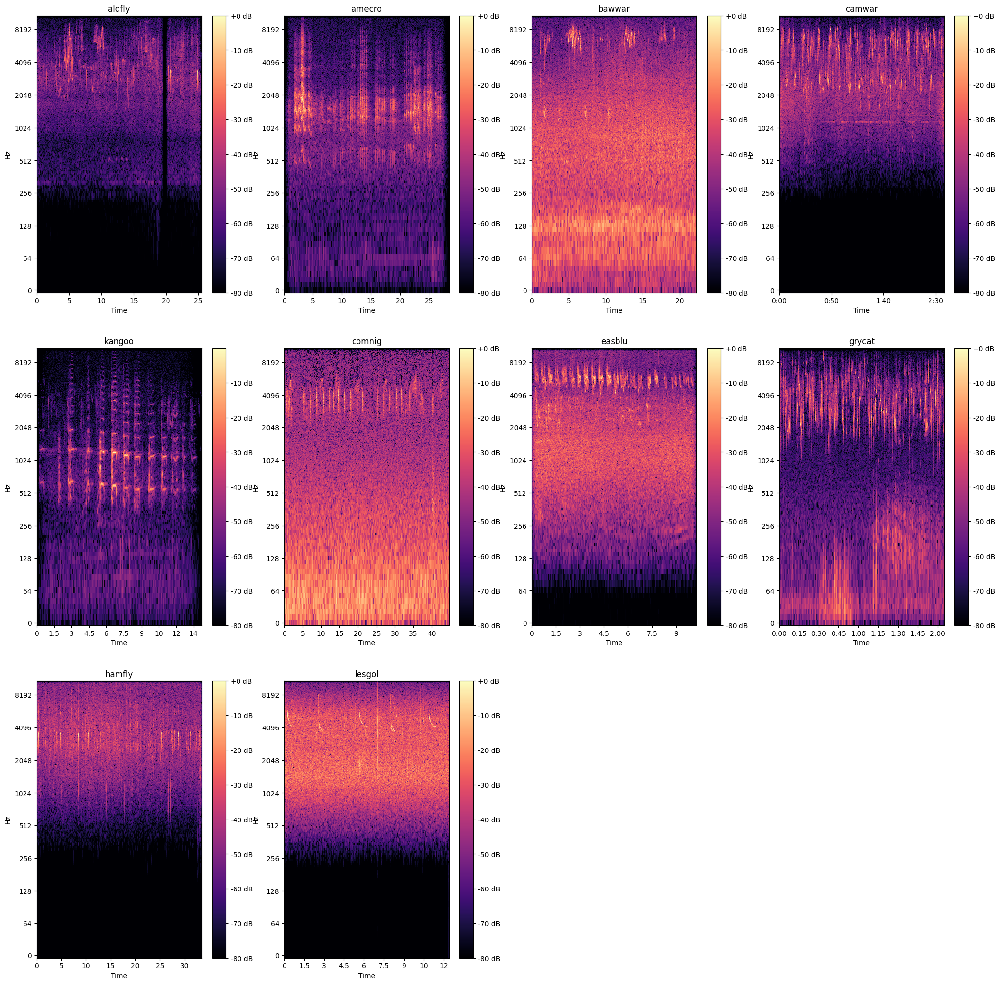

In [27]:
audio_list=[]
sr=[]
for audio_file_path in audio_file_paths:
    # Create an Audio instance for the audio file
    data_audio, sample_rate = librosa.load(audio_file_path)
    audio_list.append(data_audio)
    sr.append(sample_rate)


D1 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[0])), ref=np.max)
D2 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[1])), ref=np.max)
D3 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[2])), ref=np.max)
D4 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[3])), ref=np.max)
D5 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[4])), ref=np.max)
D6 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[5])), ref=np.max)
D7 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[6])), ref=np.max)
D8 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[7])), ref=np.max)
D9 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[8])), ref=np.max)
D10 = librosa.amplitude_to_db(np.abs(librosa.stft(audio_list[9])), ref=np.max)



# Plotting the spectrograms

plt.figure(figsize=(25,25))

plt.subplot(3,4,1)
librosa.display.specshow(D1, sr=sr[0], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('aldfly')

plt.subplot(3,4,2)
librosa.display.specshow(D2, sr=sr[1], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('amecro')

plt.subplot(3,4,3)
librosa.display.specshow(D3, sr=sr[2], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('bawwar')

plt.subplot(3,4,4)
librosa.display.specshow(D4, sr=sr[3], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('camwar')

plt.subplot(3,4,5)
librosa.display.specshow(D5, sr=sr[4], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('kangoo')

plt.subplot(3,4,6)
librosa.display.specshow(D6, sr=sr[5], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('comnig')


plt.subplot(3,4,7)
librosa.display.specshow(D7, sr=sr[6], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('easblu')


plt.subplot(3,4,8)
librosa.display.specshow(D8, sr=sr[7], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('grycat')


plt.subplot(3,4,9)
librosa.display.specshow(D9, sr=sr[8], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('hamfly')


plt.subplot(3,4,10)
librosa.display.specshow(D10, sr=sr[9], x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('lesgol')




plt.show()

In [28]:
TARGET_SR = 32000
TEST = Path("/kaggle/input/birdcall-check/test_audio").exists()

In [29]:



if TEST:
    DATA_DIR = Path("/kaggle/input/birdsong-recognition")
else:
    # dataset created by @shonenkov, thanks!
    DATA_DIR = Path("/kaggle/input/birdcall-check")
    

test = pd.read_csv("/kaggle/input/birdcall-check/test.csv")
test_audio = "/kaggle/input/birdcall-check/test_audio"


test.head()


,site,row_id,seconds,audio_id
0,site_1,site_1_41e6fe6504a34bf6846938ba78d13df1_5,5.0,41e6fe6504a34bf6846938ba78d13df1
1,site_1,site_1_41e6fe6504a34bf6846938ba78d13df1_10,10.0,41e6fe6504a34bf6846938ba78d13df1
2,site_1,site_1_41e6fe6504a34bf6846938ba78d13df1_15,15.0,41e6fe6504a34bf6846938ba78d13df1
3,site_1,site_1_41e6fe6504a34bf6846938ba78d13df1_20,20.0,41e6fe6504a34bf6846938ba78d13df1
4,site_1,site_1_41e6fe6504a34bf6846938ba78d13df1_25,25.0,41e6fe6504a34bf6846938ba78d13df1


In [30]:
test_audio_data=pd.read_csv('/kaggle/input/birdsong-recognition/example_test_audio_metadata.csv')
test_audio_data

,file_id,device,date,hour,source,ebird_code,certainty,vox_type,time_start,time_end,channel
0,BLKFR-10-CPL_20190611_093000,BLKFR-10-CPL,20190611,93000,jack,westan,c,call,0.255394,0.858845,2
1,ORANGE-7-CAP_20190606_093000,ORANGE-7-CAP,20190606,93000,jack,squirrel,c,call,0.415966,1.410334,1
2,BLKFR-10-CPL_20190611_093000,BLKFR-10-CPL,20190611,93000,jack,gockin,l,call,0.590725,1.944412,2
3,BLKFR-10-CPL_20190611_093000,BLKFR-10-CPL,20190611,93000,jack,mouchi,c,call,1.609081,2.130985,2
4,ORANGE-7-CAP_20190606_093000,ORANGE-7-CAP,20190606,93000,jack,brncre,c,song,2.461655,2.746925,1
...,...,...,...,...,...,...,...,...,...,...,...
250,ORANGE-7-CAP_20190606_093000,ORANGE-7-CAP,20190606,93000,jack,squirrel,c,call,295.981139,296.559829,2
251,ORANGE-7-CAP_20190606_093000,ORANGE-7-CAP,20190606,93000,jack,westan,c,song,296.614276,299.295811,2
252,ORANGE-7-CAP_20190606_093000,ORANGE-7-CAP,20190606,93000,jack,squirrel,c,call,299.777789,300.592846,2
253,BLKFR-10-CPL_20190611_093000,BLKFR-10-CPL,20190611,93000,jack,yerwar,l,song,458.834619,461.232113,2


In [31]:
test_summary_data=pd.read_csv('/kaggle/input/birdsong-recognition/example_test_audio_summary.csv')
test_summary_data

#/kaggle/input/birdsong-recognition/example_test_audio/BLKFR-10-CPL_20190611_093000.pt540.mp3
#/kaggle/input/birdsong-recognition/example_test_audio/ORANGE-7-CAP_20190606_093000.pt623.mp3

,filename_seconds,birds,filename,seconds
0,BLKFR-10-CPL_20190611_093000_5,gockin mouchi westan,BLKFR-10-CPL,5
1,BLKFR-10-CPL_20190611_093000_10,gockin westan,BLKFR-10-CPL,10
2,BLKFR-10-CPL_20190611_093000_15,gockin westan,BLKFR-10-CPL,15
3,BLKFR-10-CPL_20190611_093000_20,mouchi,BLKFR-10-CPL,20
4,BLKFR-10-CPL_20190611_093000_25,mouchi,BLKFR-10-CPL,25
...,...,...,...,...
148,ORANGE-7-CAP_20190606_093000_280,mouqua squirrel,ORANGE-7-CAP,280
149,ORANGE-7-CAP_20190606_093000_285,mouqua squirrel westan,ORANGE-7-CAP,285
150,ORANGE-7-CAP_20190606_093000_290,mouqua westan,ORANGE-7-CAP,290
151,ORANGE-7-CAP_20190606_093000_295,mouqua squirrel,ORANGE-7-CAP,295


In [32]:
class ResNet(nn.Module):
    def __init__(self, base_model_name: str, pretrained=False,
                 num_classes=264):
        super().__init__()
        base_model = models.__getattribute__(base_model_name)(
            pretrained=pretrained)
        layers = list(base_model.children())[:-2]
        layers.append(nn.AdaptiveMaxPool2d(1))
        self.encoder = nn.Sequential(*layers)

        in_features = base_model.fc.in_features

        self.classifier = nn.Sequential(
            nn.Linear(in_features, 1024), nn.ReLU(), nn.Dropout(p=0.2),
            nn.Linear(1024, 1024), nn.ReLU(), nn.Dropout(p=0.2),
            nn.Linear(1024, num_classes))

    def forward(self, x):
        batch_size = x.size(0)
        x = self.encoder(x).view(batch_size, -1)
        x = self.classifier(x)
        multiclass_proba = F.softmax(x, dim=1)
        multilabel_proba = F.sigmoid(x)
        return {
            "logits": x,
            "multiclass_proba": multiclass_proba,
            "multilabel_proba": multilabel_proba
        }

In [33]:

model_config = {
    "base_model_name": "resnet50",
    "pretrained": False,
    "num_classes": 264
}

melspectrogram_parameters = {
    "n_mels": 128,
    "fmin": 30,
    "fmax": 15500
}

weights_path = "/kaggle/input/weights/best.pth"

In [34]:
def mono_to_color(X: np.ndarray,
                  mean=None,
                  std=None,
                  norm_max=None,
                  norm_min=None,
                  eps=1e-6):    
    # Stack X as [X,X,X]
    X = np.stack([X, X, X], axis=-1)

    # Standardize
    mean = mean or X.mean()
    X = X - mean
    std = std or X.std()
    Xstd = X / (std + eps)
    _min, _max = Xstd.min(), Xstd.max()
    norm_max = norm_max or _max
    norm_min = norm_min or _min
    if (_max - _min) > eps:
        # Normalize to [0, 255]
        V = Xstd
        V[V < norm_min] = norm_min
        V[V > norm_max] = norm_max
        V = 255 * (V - norm_min) / (norm_max - norm_min)
        V = V.astype(np.uint8)
    else:
        # Just zero
        V = np.zeros_like(Xstd, dtype=np.uint8)
    return V


class TestDataset(Dataset):
    def __init__(self, df: pd.DataFrame, clip: np.ndarray,
                 img_size=224, melspectrogram_parameters={}):
        self.df = df
        self.clip = clip
        self.img_size = img_size
        self.melspectrogram_parameters = melspectrogram_parameters
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, idx: int):
        SR = 32000
        sample = self.df.loc[idx, :]
        site = sample.site
        row_id = sample.row_id
        
        if site == "site_3":
            y = self.clip.astype(np.float32)
            len_y = len(y)
            start = 0
            end = SR * 5
            images = []
            while len_y > start:
                y_batch = y[start:end].astype(np.float32)
                if len(y_batch) != (SR * 5):
                    break
                start = end
                end = end + SR * 5
                
                melspec = librosa.feature.melspectrogram(y=y_batch,
                                                         sr=SR,
                                                         **self.melspectrogram_parameters)
                melspec = librosa.power_to_db(melspec).astype(np.float32)
                image = mono_to_color(melspec)
                height, width, _ = image.shape
                image = cv2.resize(image, (int(width * self.img_size / height), self.img_size))
                image = np.moveaxis(image, 2, 0)
                image = (image / 255.0).astype(np.float32)
                images.append(image)
            images = np.asarray(images)
            return images, row_id, site
        else:
            end_seconds = int(sample.seconds)
            start_seconds = int(end_seconds - 5)
            
            start_index = SR * start_seconds
            end_index = SR * end_seconds
            
            y = self.clip[start_index:end_index].astype(np.float32)

            melspec = librosa.feature.melspectrogram(y=y, sr=SR, **self.melspectrogram_parameters)
            melspec = librosa.power_to_db(melspec).astype(np.float32)

            image = mono_to_color(melspec)
            height, width, _ = image.shape
            image = cv2.resize(image, (int(width * self.img_size / height), self.img_size))
            image = np.moveaxis(image, 2, 0)
            image = (image / 255.0).astype(np.float32)

            return image, row_id, site

In [35]:
def get_model(config: dict, weights_path: str):
    model = ResNet(**config)
    checkpoint = torch.load(weights_path,map_location='cpu')
    model.load_state_dict(checkpoint["model_state_dict"])
    device = torch.device("cpu")

    model.to(device)
    model.eval()
    return model

In [36]:
def prediction_for_clip(test_df: pd.DataFrame, 
                        clip: np.ndarray, 
                        model: ResNet, 
                        mel_params: dict, 
                        threshold=0.5):

    dataset = TestDataset(df=test_df, 
                          clip=clip,
                          img_size=224,
                          melspectrogram_parameters=mel_params)
    loader = DataLoader(dataset, batch_size=1, shuffle=False)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    model.eval()
    prediction_dict = {}
    for image, row_id, site in progress_bar(loader):
        site = site[0]
        row_id = row_id[0]
        if site in {"site_1", "site_2"}:
            image = image.to(device)

            with torch.no_grad():
                prediction = model(image)
                proba = prediction["multilabel_proba"].detach().cpu().numpy().reshape(-1)

            events = proba >= threshold
            labels = np.argwhere(events).reshape(-1).tolist()

        else:
            # to avoid prediction on large batch
            image = image.squeeze(0)
            batch_size = 16
            whole_size = image.size(0)
            if whole_size % batch_size == 0:
                n_iter = whole_size // batch_size
            else:
                n_iter = whole_size // batch_size + 1
                
            all_events = set()
            for batch_i in range(n_iter):
                batch = image[batch_i * batch_size:(batch_i + 1) * batch_size]
                if batch.ndim == 3:
                    batch = batch.unsqueeze(0)

                batch = batch.to(device)
                with torch.no_grad():
                    prediction = model(batch)
                    proba = prediction["multilabel_proba"].detach().cpu().numpy()
                    
                events = proba >= threshold
                for i in range(len(events)):
                    event = events[i, :]
                    labels = np.argwhere(event).reshape(-1).tolist()
                    for label in labels:
                        all_events.add(label)
                        
            labels = list(all_events)
        if len(labels) == 0:
            prediction_dict[row_id] = "nocall"
        else:
            labels_str_list = list(map(lambda x: bird_code[x], labels))
            label_string = " ".join(labels_str_list)
            prediction_dict[row_id] = label_string
    return prediction_dict

In [37]:
def prediction(test_df: pd.DataFrame,
               test_audio: Path,
               model_config: dict,
               mel_params: dict,
               weights_path: str,
               threshold=0.5):
    model = get_model(model_config, weights_path)
    unique_audio_id = test_df.audio_id.unique()

    warnings.filterwarnings("ignore")
    prediction_dfs = []
    for audio_id in unique_audio_id:
        with timer(f"Loading {audio_id}", logger):
            clip, _ = librosa.load(test_audio+'/' + audio_id + ".mp3",
                                   sr=TARGET_SR,
                                   mono=True,
                                   res_type="scipy")
        
        test_df_for_audio_id = test_df.query(
            f"audio_id == '{audio_id}'").reset_index(drop=True)
        with timer(f"Prediction on {audio_id}", logger):
            prediction_dict = prediction_for_clip(test_df_for_audio_id,
                                                  clip=clip,
                                                  model=model,
                                                  mel_params=mel_params,
                                                  threshold=threshold)
        row_id = list(prediction_dict.keys())
        birds = list(prediction_dict.values())
        prediction_df = pd.DataFrame({
            "row_id": row_id,
            "birds": birds
        })
        prediction_dfs.append(prediction_df)
    
    prediction_df = pd.concat(prediction_dfs, axis=0, sort=False).reset_index(drop=True)
    return prediction_df


In [38]:

submission = prediction(test_df=test,
                        test_audio=test_audio,
                        model_config=model_config,
                        mel_params=melspectrogram_parameters,
                        weights_path=weights_path,
                        threshold=0.8)


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
2024-01-24 14:37:17,404 - INFO - [Loading 41e6fe6504a34bf6846938ba78d13df1] start
2024-01-24 14:37:17,538 - INFO - [Loading 41e6fe6504a34bf6846938ba78d13df1] done in 0.13 s
2024-01-24 14:37:17,546 - INFO - [Prediction on 41e6fe6504a34bf6846938ba78d13df1] start


2024-01-24 14:37:21,131 - INFO - [Prediction on 41e6fe6504a34bf6846938ba78d13df1] done in 3.59 s
2024-01-24 14:37:21,136 - INFO - [Loading cce64fffafed40f2b2f3d3413ec1c4c2] start
2024-01-24 14:37:21,670 - INFO - [Loading cce64fffafed40f2b2f3d3413ec1c4c2] done in 0.53 s
2024-01-24 14:37:21,675 - INFO - [Prediction on cce64fffafed40f2b2f3d3413ec1c4c2] start


2024-01-24 14:37:24,321 - INFO - [Prediction on cce64fffafed40f2b2f3d3413ec1c4c2] done in 2.65 s
2024-01-24 14:37:24,324 - INFO - [Loading 99af324c881246949408c0b1ae54271f] start
2024-01-24 14:37:24,965 - INFO - [Loading 99af324c881246949408c0b1ae54271f] done in 0.64 s
2024-01-24 14:37:24,974 - INFO - [Prediction on 99af324c881246949408c0b1ae54271f] start


2024-01-24 14:37:27,599 - INFO - [Prediction on 99af324c881246949408c0b1ae54271f] done in 2.63 s
2024-01-24 14:37:27,603 - INFO - [Loading 6ab74e177aa149468a39ca10beed6222] start
2024-01-24 14:37:28,117 - INFO - [Loading 6ab74e177aa149468a39ca10beed6222] done in 0.51 s
2024-01-24 14:37:28,124 - INFO - [Prediction on 6ab74e177aa149468a39ca10beed6222] start


2024-01-24 14:37:30,605 - INFO - [Prediction on 6ab74e177aa149468a39ca10beed6222] done in 2.48 s
2024-01-24 14:37:30,607 - INFO - [Loading b2fd3f01e9284293a1e33f9c811a2ed6] start
2024-01-24 14:37:31,062 - INFO - [Loading b2fd3f01e9284293a1e33f9c811a2ed6] done in 0.46 s
2024-01-24 14:37:31,068 - INFO - [Prediction on b2fd3f01e9284293a1e33f9c811a2ed6] start


2024-01-24 14:37:33,684 - INFO - [Prediction on b2fd3f01e9284293a1e33f9c811a2ed6] done in 2.62 s
2024-01-24 14:37:33,686 - INFO - [Loading de62b37ebba749d2abf29d4a493ea5d4] start
2024-01-24 14:37:33,763 - INFO - [Loading de62b37ebba749d2abf29d4a493ea5d4] done in 0.08 s
2024-01-24 14:37:33,770 - INFO - [Prediction on de62b37ebba749d2abf29d4a493ea5d4] start


2024-01-24 14:37:34,162 - INFO - [Prediction on de62b37ebba749d2abf29d4a493ea5d4] done in 0.39 s
2024-01-24 14:37:34,164 - INFO - [Loading 8680a8dd845d40f296246dbed0d37394] start
2024-01-24 14:37:34,758 - INFO - [Loading 8680a8dd845d40f296246dbed0d37394] done in 0.59 s
2024-01-24 14:37:34,766 - INFO - [Prediction on 8680a8dd845d40f296246dbed0d37394] start


2024-01-24 14:37:38,145 - INFO - [Prediction on 8680a8dd845d40f296246dbed0d37394] done in 3.38 s
2024-01-24 14:37:38,150 - INFO - [Loading 940d546e5eb745c9a74bce3f35efa1f9] start
2024-01-24 14:37:38,627 - INFO - [Loading 940d546e5eb745c9a74bce3f35efa1f9] done in 0.48 s
2024-01-24 14:37:38,632 - INFO - [Prediction on 940d546e5eb745c9a74bce3f35efa1f9] start


2024-01-24 14:37:43,843 - INFO - [Prediction on 940d546e5eb745c9a74bce3f35efa1f9] done in 5.21 s
2024-01-24 14:37:43,846 - INFO - [Loading 07ab324c602e4afab65ddbcc746c31b5] start
2024-01-24 14:37:44,168 - INFO - [Loading 07ab324c602e4afab65ddbcc746c31b5] done in 0.32 s
2024-01-24 14:37:44,174 - INFO - [Prediction on 07ab324c602e4afab65ddbcc746c31b5] start


2024-01-24 14:37:46,032 - INFO - [Prediction on 07ab324c602e4afab65ddbcc746c31b5] done in 1.86 s
2024-01-24 14:37:46,034 - INFO - [Loading 899616723a32409c996f6f3441646c2a] start
2024-01-24 14:37:46,256 - INFO - [Loading 899616723a32409c996f6f3441646c2a] done in 0.22 s
2024-01-24 14:37:46,262 - INFO - [Prediction on 899616723a32409c996f6f3441646c2a] start


2024-01-24 14:37:50,107 - INFO - [Prediction on 899616723a32409c996f6f3441646c2a] done in 3.85 s
2024-01-24 14:37:50,108 - INFO - [Loading 9cc5d9646f344f1bbb52640a988fe902] start
2024-01-24 14:37:52,322 - INFO - [Loading 9cc5d9646f344f1bbb52640a988fe902] done in 2.21 s
2024-01-24 14:37:52,327 - INFO - [Prediction on 9cc5d9646f344f1bbb52640a988fe902] start


2024-01-24 14:38:14,662 - INFO - [Prediction on 9cc5d9646f344f1bbb52640a988fe902] done in 22.34 s
2024-01-24 14:38:14,666 - INFO - [Loading a56e20a518684688a9952add8a9d5213] start
2024-01-24 14:38:15,112 - INFO - [Loading a56e20a518684688a9952add8a9d5213] done in 0.45 s
2024-01-24 14:38:15,118 - INFO - [Prediction on a56e20a518684688a9952add8a9d5213] start


2024-01-24 14:38:17,341 - INFO - [Prediction on a56e20a518684688a9952add8a9d5213] done in 2.22 s
2024-01-24 14:38:17,343 - INFO - [Loading 96779836288745728306903d54e264dd] start
2024-01-24 14:38:17,554 - INFO - [Loading 96779836288745728306903d54e264dd] done in 0.21 s
2024-01-24 14:38:17,560 - INFO - [Prediction on 96779836288745728306903d54e264dd] start


2024-01-24 14:38:18,724 - INFO - [Prediction on 96779836288745728306903d54e264dd] done in 1.16 s
2024-01-24 14:38:18,726 - INFO - [Loading f77783ba4c6641bc918b034a18c23e53] start
2024-01-24 14:38:18,816 - INFO - [Loading f77783ba4c6641bc918b034a18c23e53] done in 0.09 s
2024-01-24 14:38:18,821 - INFO - [Prediction on f77783ba4c6641bc918b034a18c23e53] start


2024-01-24 14:38:19,203 - INFO - [Prediction on f77783ba4c6641bc918b034a18c23e53] done in 0.38 s
2024-01-24 14:38:19,205 - INFO - [Loading 856b194b097441958697c2bcd1f63982] start
2024-01-24 14:38:19,535 - INFO - [Loading 856b194b097441958697c2bcd1f63982] done in 0.33 s
2024-01-24 14:38:19,540 - INFO - [Prediction on 856b194b097441958697c2bcd1f63982] start


2024-01-24 14:38:21,185 - INFO - [Prediction on 856b194b097441958697c2bcd1f63982] done in 1.65 s


In [39]:
submission=submission.head(15)
submission

,row_id,birds
0,site_1_41e6fe6504a34bf6846938ba78d13df1_5,aldfly
1,site_1_41e6fe6504a34bf6846938ba78d13df1_10,aldfly
2,site_1_41e6fe6504a34bf6846938ba78d13df1_15,aldfly
3,site_1_41e6fe6504a34bf6846938ba78d13df1_20,nocall
4,site_1_41e6fe6504a34bf6846938ba78d13df1_25,aldfly
5,site_1_cce64fffafed40f2b2f3d3413ec1c4c2_5,aldfly
6,site_1_cce64fffafed40f2b2f3d3413ec1c4c2_10,nocall
7,site_1_cce64fffafed40f2b2f3d3413ec1c4c2_15,nocall
8,site_1_cce64fffafed40f2b2f3d3413ec1c4c2_20,nocall
9,site_1_cce64fffafed40f2b2f3d3413ec1c4c2_25,aldfly


In [40]:
submission.to_csv("submission.csv", index=False)